<a href="https://colab.research.google.com/github/harinivasudatla/Harini_Datla/blob/main/breast_cancer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Wisconsin Breast Cancer Dataset



## Exploratory data analysis

We will follow our well-trodden path of systematically load the data, explore and visualize it.

### Load data and observe its statistics

In [ ]:
data = pd.read_csv ("https://raw.githubusercontent.com/supportvectors/ml-100/master/wisconsin-diagnostic-breast-cancer.csv")
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [ ]:
data.drop(columns=['Unnamed: 32', 'id'], inplace=True)
data.describe(include='all').transpose().style.set_table_styles(sv_table_styles())

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
diagnosis,569,2,B,357,nan,nan,nan,nan,nan,nan,nan
radius_mean,569.000000,nan,nan,nan,14.127292,3.524049,6.981000,11.700000,13.370000,15.780000,28.110000
texture_mean,569.000000,nan,nan,nan,19.289649,4.301036,9.710000,16.170000,18.840000,21.800000,39.280000
perimeter_mean,569.000000,nan,nan,nan,91.969033,24.298981,43.790000,75.170000,86.240000,104.100000,188.500000
area_mean,569.000000,nan,nan,nan,654.889104,351.914129,143.500000,420.300000,551.100000,782.700000,2501.000000
smoothness_mean,569.000000,nan,nan,nan,0.096360,0.014064,0.052630,0.086370,0.095870,0.105300,0.163400
compactness_mean,569.000000,nan,nan,nan,0.104341,0.052813,0.019380,0.064920,0.092630,0.130400,0.345400
concavity_mean,569.000000,nan,nan,nan,0.088799,0.079720,0.000000,0.029560,0.061540,0.130700,0.426800
concave points_mean,569.000000,nan,nan,nan,0.048919,0.038803,0.000000,0.020310,0.033500,0.074000,0.201200
symmetry_mean,569.000000,nan,nan,nan,0.181162,0.027414,0.106000,0.161900,0.179200,0.195700,0.304000


In [ ]:
data.sample(10).transpose()

,204,70,131,431,540,567,369,29,81,477
diagnosis,B,M,M,B,B,M,M,M,B,B
radius_mean,12.47,18.94,15.46,12.4,11.54,20.6,22.01,17.57,13.34,13.9
texture_mean,18.6,21.31,19.48,17.68,14.44,29.33,21.9,15.05,15.86,16.62
perimeter_mean,81.09,123.6,101.7,81.47,74.65,140.1,147.2,115,86.49,88.97
area_mean,481.9,1130,748.9,467.8,402.9,1265,1482,955.1,520,599.4
smoothness_mean,0.09965,0.09009,0.1092,0.1054,0.09984,0.1178,0.1063,0.09847,0.1078,0.06828
compactness_mean,0.1058,0.1029,0.1223,0.1316,0.112,0.277,0.1954,0.1157,0.1535,0.05319
concavity_mean,0.08005,0.108,0.1466,0.07741,0.06737,0.3514,0.2448,0.09875,0.1169,0.02224
concave points_mean,0.03821,0.07951,0.08087,0.02799,0.02594,0.152,0.1501,0.07953,0.06987,0.01339
symmetry_mean,0.1925,0.1582,0.1931,0.1811,0.1818,0.2397,0.1824,0.1739,0.1942,0.1813


### Missing Value Analysis

In [ ]:
data.isnull().sum()

diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64

### Data imbalance check

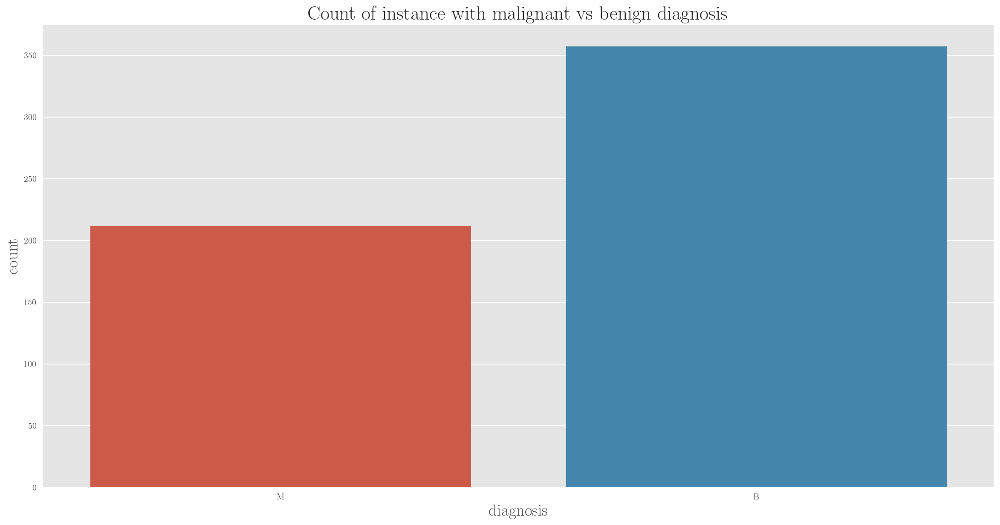

In [ ]:
sns.countplot(x='diagnosis', data=data);
plt.title('Count of instance with malignant vs benign diagnosis');

In [ ]:
data.diagnosis.value_counts()

B    357
M    212
Name: diagnosis, dtype: int64

Therefore any classifier must do better than the baseline prediction accuracy of $\frac{357}{579} = 63.4\% $

### Violin-plot and box-plot of features by diagnosis

Considering that we have a large number of predictors, let us first start by looking at their data distribution plots as violin-plots and box-plots.

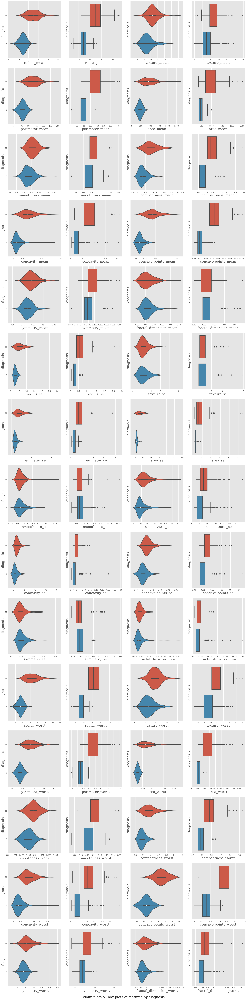

In [ ]:
rc('text', usetex=False)
features = data.columns.tolist()
features.remove('diagnosis') # it is a categorical

# Because there are 7 numerical features
fig, axes = plt.subplots(15,4, sharey=True, figsize=(20,80));
for i in range(len(features)):
    row = int(i/2)
    col = 0 if i %2 == 0 else 2

    sns.violinplot(  y    = 'diagnosis',
                     x    = features[i],
                     data = data,ax=axes[row, col], figsize=(5,5));
    sns.boxplot   (  y    = 'diagnosis',
                     x    = features[i],
                     data = data,ax=axes[row, col+1]);

fig.suptitle('Violin-plots &  box-plots of features by diagnosis', y=0);
plt.tight_layout()


The observant reader will notice *that the diagnosis is often-times well separated by a single feature*, such as `radius_mean`. To illustrate this, let us single out the relevant boxplot:

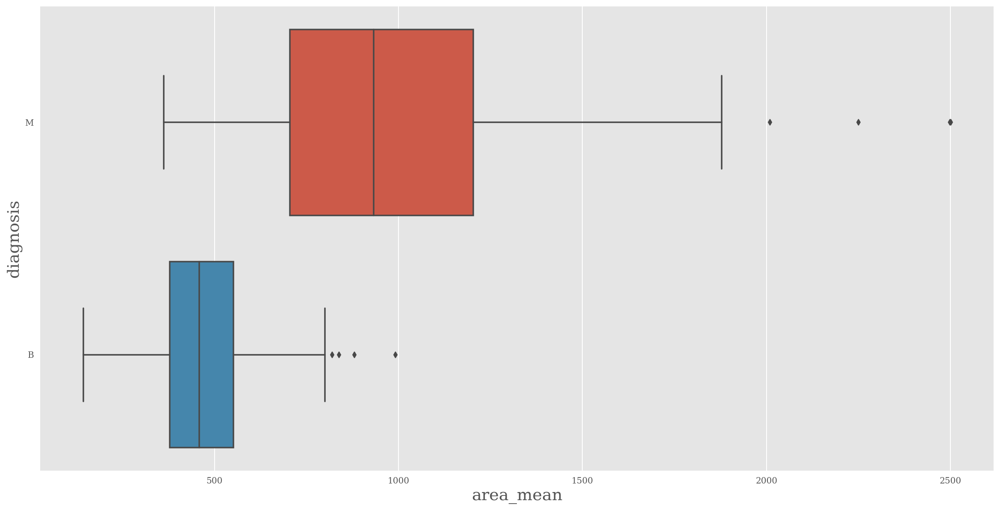

In [ ]:
sns.boxplot(  y    = 'diagnosis',
                     x    = 'area_mean',
                     data = data);

It almost seems to make creating a classifier somewhat unnecessary: one is tempted to draw a decision-boundary visually by considering, say `area_mean = 600` as a decision-boundary, and ignore other predictors. We will see later how well this holds up when we build the classifier models.

## Correlation

Let us now study the correlation between features. Recall that it is generally good indication to observe strong correlation between the target variable (here, `mpg`) and the predictions. However, linear models are adversely affected if there is a present of strong correlation among the predictors, i.e. multicollinearity.

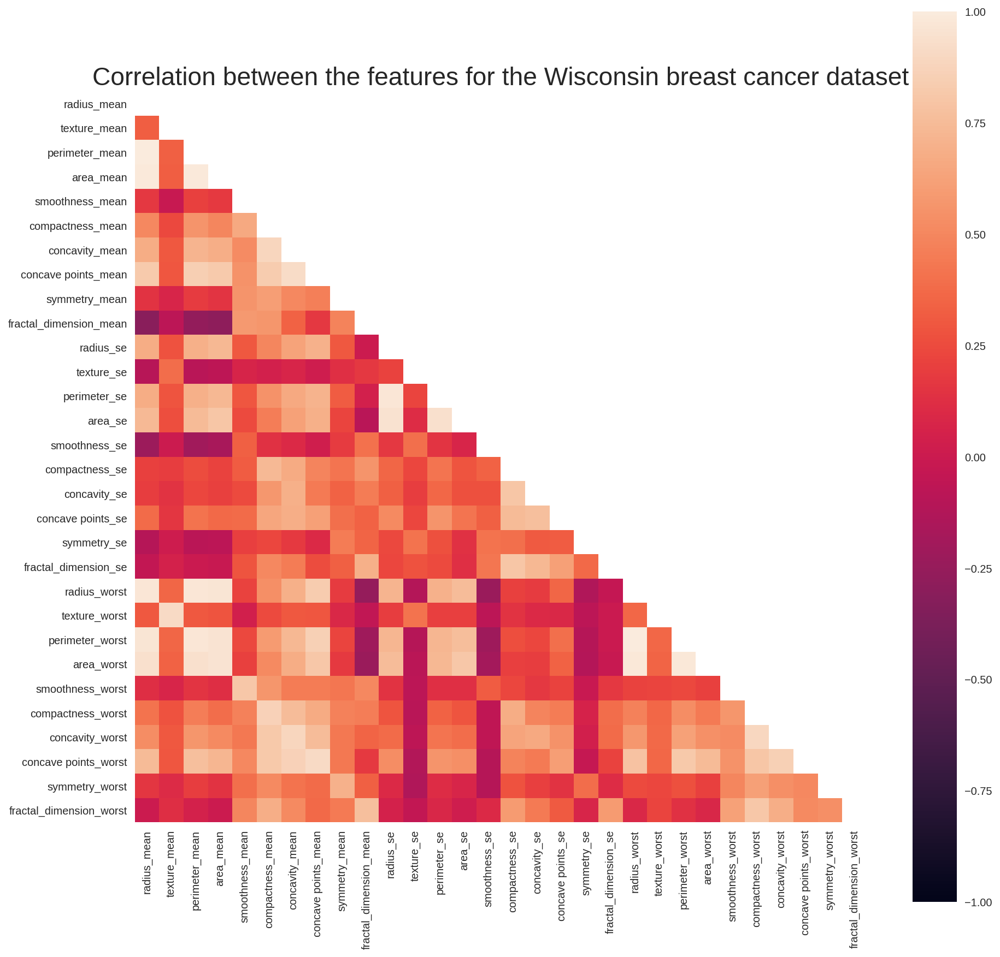

In [ ]:
corr = data.corr()
import numpy as np
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(15, 15))
    ax = sns.heatmap(corr, mask=mask, vmax=1, vmin=-1, square=True)
plt.title('Correlation between the features for the Wisconsin breast cancer dataset');

In [ ]:
pd.options.display.float_format = '${:,.2f}'.format
format_vertical_headers(corr)\
.format("{:.2f}")\
.applymap(lambda x: 'background-color : yellow' if x>=0.85 else '')

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
radius_mean,1.00,0.32,1.00,0.99,0.17,0.51,0.68,0.82,0.15,-0.31,0.68,-0.10,0.67,0.74,-0.22,0.21,0.19,0.38,-0.10,-0.04,0.97,0.30,0.97,0.94,0.12,0.41,0.53,0.74,0.16,0.01
texture_mean,0.32,1.00,0.33,0.32,-0.02,0.24,0.30,0.29,0.07,-0.08,0.28,0.39,0.28,0.26,0.01,0.19,0.14,0.16,0.01,0.05,0.35,0.91,0.36,0.34,0.08,0.28,0.30,0.30,0.11,0.12
perimeter_mean,1.00,0.33,1.00,0.99,0.21,0.56,0.72,0.85,0.18,-0.26,0.69,-0.09,0.69,0.74,-0.20,0.25,0.23,0.41,-0.08,-0.01,0.97,0.30,0.97,0.94,0.15,0.46,0.56,0.77,0.19,0.05
area_mean,0.99,0.32,0.99,1.00,0.18,0.50,0.69,0.82,0.15,-0.28,0.73,-0.07,0.73,0.80,-0.17,0.21,0.21,0.37,-0.07,-0.02,0.96,0.29,0.96,0.96,0.12,0.39,0.51,0.72,0.14,0.00
smoothness_mean,0.17,-0.02,0.21,0.18,1.00,0.66,0.52,0.55,0.56,0.58,0.30,0.07,0.30,0.25,0.33,0.32,0.25,0.38,0.20,0.28,0.21,0.04,0.24,0.21,0.81,0.47,0.43,0.50,0.39,0.50
compactness_mean,0.51,0.24,0.56,0.50,0.66,1.00,0.88,0.83,0.60,0.57,0.50,0.05,0.55,0.46,0.14,0.74,0.57,0.64,0.23,0.51,0.54,0.25,0.59,0.51,0.57,0.87,0.82,0.82,0.51,0.69
concavity_mean,0.68,0.30,0.72,0.69,0.52,0.88,1.00,0.92,0.50,0.34,0.63,0.08,0.66,0.62,0.10,0.67,0.69,0.68,0.18,0.45,0.69,0.30,0.73,0.68,0.45,0.75,0.88,0.86,0.41,0.51
concave points_mean,0.82,0.29,0.85,0.82,0.55,0.83,0.92,1.00,0.46,0.17,0.70,0.02,0.71,0.69,0.03,0.49,0.44,0.62,0.10,0.26,0.83,0.29,0.86,0.81,0.45,0.67,0.75,0.91,0.38,0.37
symmetry_mean,0.15,0.07,0.18,0.15,0.56,0.60,0.50,0.46,1.00,0.48,0.30,0.13,0.31,0.22,0.19,0.42,0.34,0.39,0.45,0.33,0.19,0.09,0.22,0.18,0.43,0.47,0.43,0.43,0.70,0.44
fractal_dimension_mean,-0.31,-0.08,-0.26,-0.28,0.58,0.57,0.34,0.17,0.48,1.00,0.00,0.16,0.04,-0.09,0.40,0.56,0.45,0.34,0.35,0.69,-0.25,-0.05,-0.21,-0.23,0.50,0.46,0.35,0.18,0.33,0.77


Observe the presence of strong correlations, that can degrade the performance of the linear models, owing to multicollinearity.


In view of this, let us remember to drop many of these high-correlation columns from the logistic regression model we will build.

In [ ]:
correlated_cols_to_drop = [ 'perimeter_se',
                           'area_se',
                           'radius_worst',
                           'perimeter_worst',
                           'area_worst',
                           'compactness_worst',
                           'concavity_worst',
                           'concave points_worst',
]

### Pair plots

Considering the large number of predictors, let us partition them into three subsets, based on the feature name suffixes.

In [ ]:
mean_features = [feature for feature in data.columns if '_mean' in feature]
se_features = [feature for feature in data.columns if '_se' in feature]
worst_features = [feature for feature in data.columns if '_worst' in feature]

In [ ]:
mean_features.append('diagnosis')
se_features.append('diagnosis')
worst_features.append('diagnosis')

#### Pair-plot for `_mean` features

In [ ]:
rc('text', usetex=False) # the _ in the feature names will break tex
sns.set_palette("viridis")
sample = data[mean_features]
sample.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
radius_mean,$569.00,NaN,NaN,NaN,$14.13,$3.52,$6.98,$11.70,$13.37,$15.78,$28.11
texture_mean,$569.00,NaN,NaN,NaN,$19.29,$4.30,$9.71,$16.17,$18.84,$21.80,$39.28
perimeter_mean,$569.00,NaN,NaN,NaN,$91.97,$24.30,$43.79,$75.17,$86.24,$104.10,$188.50
area_mean,$569.00,NaN,NaN,NaN,$654.89,$351.91,$143.50,$420.30,$551.10,$782.70,"$2,501.00"
smoothness_mean,$569.00,NaN,NaN,NaN,$0.10,$0.01,$0.05,$0.09,$0.10,$0.11,$0.16
compactness_mean,$569.00,NaN,NaN,NaN,$0.10,$0.05,$0.02,$0.06,$0.09,$0.13,$0.35
concavity_mean,$569.00,NaN,NaN,NaN,$0.09,$0.08,$0.00,$0.03,$0.06,$0.13,$0.43
concave points_mean,$569.00,NaN,NaN,NaN,$0.05,$0.04,$0.00,$0.02,$0.03,$0.07,$0.20
symmetry_mean,$569.00,NaN,NaN,NaN,$0.18,$0.03,$0.11,$0.16,$0.18,$0.20,$0.30
fractal_dimension_mean,$569.00,NaN,NaN,NaN,$0.06,$0.01,$0.05,$0.06,$0.06,$0.07,$0.10


In [ ]:
g = sns.pairplot(sample, diag_kind='kde',
                   plot_kws = { 'alpha': 0.20, 's': 30, 'edgecolor': 'k',  },
                   size=5, hue='diagnosis');
g.map_diag(sns.kdeplot,shade=True);
g.map_upper(plt.scatter,   alpha=0.5);
g.map_lower(sns.kdeplot, shade=False, shade_lowest=False, cbar=True);

plt.tight_layout()

#### Pair-plot for `_se` features

In [ ]:

rc('text', usetex=False) # the _ in the feature names will break tex
sns.set_palette("Set2")
sample = data[se_features]
sample.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
radius_se,$569.00,NaN,NaN,NaN,$0.41,$0.28,$0.11,$0.23,$0.32,$0.48,$2.87
texture_se,$569.00,NaN,NaN,NaN,$1.22,$0.55,$0.36,$0.83,$1.11,$1.47,$4.88
perimeter_se,$569.00,NaN,NaN,NaN,$2.87,$2.02,$0.76,$1.61,$2.29,$3.36,$21.98
area_se,$569.00,NaN,NaN,NaN,$40.34,$45.49,$6.80,$17.85,$24.53,$45.19,$542.20
smoothness_se,$569.00,NaN,NaN,NaN,$0.01,$0.00,$0.00,$0.01,$0.01,$0.01,$0.03
compactness_se,$569.00,NaN,NaN,NaN,$0.03,$0.02,$0.00,$0.01,$0.02,$0.03,$0.14
concavity_se,$569.00,NaN,NaN,NaN,$0.03,$0.03,$0.00,$0.02,$0.03,$0.04,$0.40
concave points_se,$569.00,NaN,NaN,NaN,$0.01,$0.01,$0.00,$0.01,$0.01,$0.01,$0.05
symmetry_se,$569.00,NaN,NaN,NaN,$0.02,$0.01,$0.01,$0.02,$0.02,$0.02,$0.08
fractal_dimension_se,$569.00,NaN,NaN,NaN,$0.00,$0.00,$0.00,$0.00,$0.00,$0.00,$0.03


In [ ]:
g = sns.pairplot(sample, diag_kind='kde',
                   plot_kws = { 'alpha': 0.20, 's': 30, 'edgecolor': 'k',  },
                   size=5, hue='diagnosis');
g.map_diag(sns.kdeplot,shade=True);
g.map_upper(plt.scatter,   alpha=0.5);
g.map_lower(sns.kdeplot, shade=False, shade_lowest=False, cbar=True);

plt.tight_layout()

#### Pair-plot for `_worst` features

In [ ]:
rc('text', usetex=False) # the _ in the feature names will break tex

sns.set_palette('RdBu')
sample = data[worst_features]
sample.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
radius_worst,$569.00,NaN,NaN,NaN,$16.27,$4.83,$7.93,$13.01,$14.97,$18.79,$36.04
texture_worst,$569.00,NaN,NaN,NaN,$25.68,$6.15,$12.02,$21.08,$25.41,$29.72,$49.54
perimeter_worst,$569.00,NaN,NaN,NaN,$107.26,$33.60,$50.41,$84.11,$97.66,$125.40,$251.20
area_worst,$569.00,NaN,NaN,NaN,$880.58,$569.36,$185.20,$515.30,$686.50,"$1,084.00","$4,254.00"
smoothness_worst,$569.00,NaN,NaN,NaN,$0.13,$0.02,$0.07,$0.12,$0.13,$0.15,$0.22
compactness_worst,$569.00,NaN,NaN,NaN,$0.25,$0.16,$0.03,$0.15,$0.21,$0.34,$1.06
concavity_worst,$569.00,NaN,NaN,NaN,$0.27,$0.21,$0.00,$0.11,$0.23,$0.38,$1.25
concave points_worst,$569.00,NaN,NaN,NaN,$0.11,$0.07,$0.00,$0.06,$0.10,$0.16,$0.29
symmetry_worst,$569.00,NaN,NaN,NaN,$0.29,$0.06,$0.16,$0.25,$0.28,$0.32,$0.66
fractal_dimension_worst,$569.00,NaN,NaN,NaN,$0.08,$0.02,$0.06,$0.07,$0.08,$0.09,$0.21


In [ ]:
g = sns.pairplot(sample, diag_kind='kde',
                   plot_kws = { 'alpha': 0.20, 's': 30, 'edgecolor': 'k',  },
                   size=5, hue='diagnosis');
g.map_diag(sns.kdeplot,shade=True);
g.map_upper(plt.scatter,   alpha=0.5);
g.map_lower(sns.kdeplot, shade=False, shade_lowest=False, cbar=True);

plt.tight_layout()

### Data preparation for modeling

Separate out the predictors from the response, and split the data into the training and test subsets.

In [ ]:
data['label'] = data.apply(lambda row: 1 if row.diagnosis == 'M' else 0, axis=1)
# drop highly correlated redundant cols
data.drop(columns=correlated_cols_to_drop, inplace=True)
X, y = data.drop(columns=['diagnosis', 'label']), data.label
scaler = StandardScaler()
array = scaler.fit_transform(X)
X_scaled = pd.DataFrame(columns=X.columns, data=array)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, random_state=0)

## Dummy Classifier

In order to establish a baseline performance, we will first start with the "0-R", classifier, i.e. a classifier that ignores all the predictors, and simply picks the most occurring class in the target variable.

In [ ]:
classifier = DummyClassifier()
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
confusion_matrix_ = confusion_matrix(y_test, y_pred)
print(confusion_matrix_)
print(classification_report(y_test, y_pred))

[[90  0]
 [53  0]]
              precision    recall  f1-score   support

           0       0.63      1.00      0.77        90
           1       0.00      0.00      0.00        53

    accuracy                           0.63       143
   macro avg       0.31      0.50      0.39       143
weighted avg       0.40      0.63      0.49       143



In what follows, therefore, let us pursue a classifier that improves upon these results significantly.

## Univariate Logistic Regression Classifier

Let us now attempt to model this data with a logistic regression classifier, on the hypothesis that it may be a linear dataset.

Recalling our observation that features like the `area_mean` appeared to provide a visual separation between the target class in the boxplots, let us first begin with a simple univariate logistic classifier.

In [ ]:
X, y = X_scaled[['area_mean']], data.label
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

In [ ]:
classifier =  LogisticRegression(solver='newton-cg')
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)

### Model diagnostics

In [ ]:
confusion_matrix_ = confusion_matrix(y_test, y_pred)
print(confusion_matrix_)

[[85  5]
 [ 9 44]]


In [ ]:

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.90      0.94      0.92        90
           1       0.90      0.83      0.86        53

    accuracy                           0.90       143
   macro avg       0.90      0.89      0.89       143
weighted avg       0.90      0.90      0.90       143



In [ ]:
print("{:15}: {} ".format('Classes',classifier.classes_))
print('{:15}: {} '.format('Coefficients',classifier.coef_))
print('{:15}: {} '.format('Intercept', classifier.intercept_))


Classes        : [0 1] 
Coefficients   : [[3.42389487]] 
Intercept      : [-0.32444706] 


### Class Probabilities

In the `sklearn` library, the class probabilities can be seen using the `.predict_proba(X)` method. It returns an array whose rows are the predictions for each row of `X`, and the columns are the class probabilities. In the clase of binary classifier, it is enough to retrieve the proabilities of one of the classes, since the other will be the complement of it.

In [ ]:
predictions = classifier.predict_proba(X)[:, 1].reshape(y.shape)


The `yellowbrick` library provides a succient visualization of the model metrics.

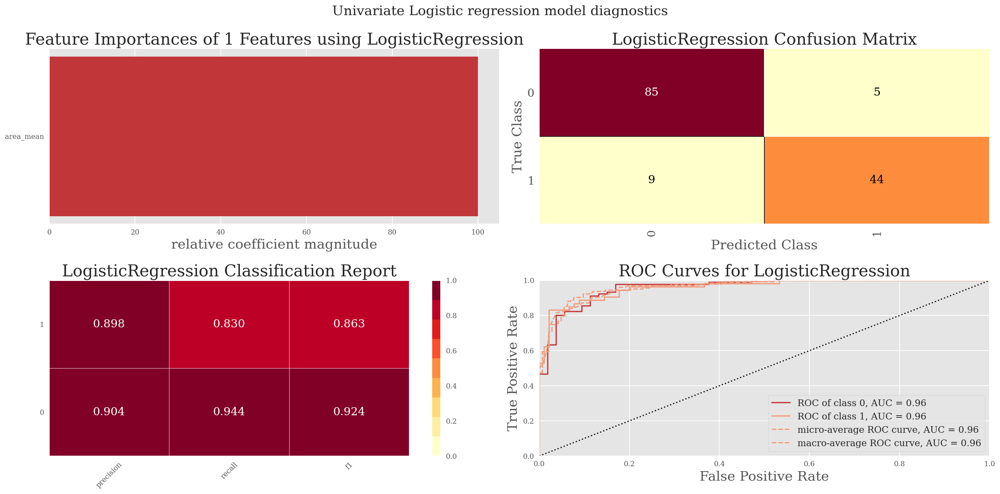

In [ ]:
rc('text', usetex=False)
fig, axes = plt.subplots(2, 2)

model = classifier
visualgrid = [
    FeatureImportances(model, ax=axes[0][0]),
    ConfusionMatrix(model, ax=axes[0][1], pos_label='M'),
    ClassificationReport(model, ax=axes[1][0], pos_label='M'),
    ROCAUC(model, classes = ['0', '1'], ax=axes[1][1], pos_label='M'),
]

for viz in visualgrid:
    viz.fit(X_train, y_train,)
    viz.score(X_test, y_test,)
    viz.finalize()

plt.suptitle(r'Univariate Logistic regression model diagnostics');
plt.tight_layout();

## Multivariate Logistic Regression Classifier

Let us now attempt to model this data with a logistic regression classifier, on the hypothesis that it may be a linear dataset.

Recalling our observation that features like the `area_mean` appeared to provide a visual separation between the target class in the boxplots, let us first begin with a simple univariate logistic classifier.

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, random_state=0)

In [ ]:
classifier =  LogisticRegression(solver='newton-cg')
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)

### Model diagnostics

In [ ]:
confusion_matrix_ = confusion_matrix(y_test, y_pred)
print(confusion_matrix_)

[[89  1]
 [ 3 50]]


In [ ]:

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98        90
           1       0.98      0.94      0.96        53

    accuracy                           0.97       143
   macro avg       0.97      0.97      0.97       143
weighted avg       0.97      0.97      0.97       143



In [ ]:
print("{:5}: {} ".format('Classes',classifier.classes_))
print('{:5}: {} '.format('Coefficients',classifier.coef_))
print('{:5}: {} '.format('Intercept', classifier.intercept_))


Classes: [0 1] 
Coefficients: [[ 0.86259654  0.48315403  0.86999955  0.92467328 -0.01134028 -0.29518512
   1.21567319  1.29421489  0.3851964  -0.44582747  2.21510349 -0.24286385
  -0.43423556 -0.7981577   0.08384081  0.58577356 -0.4215542  -0.94427
   1.10775072  0.76534023  0.81613275  0.96126048]] 
Intercept: [-0.51546499] 


### Class Probabilities

In the `sklearn` library, the class probabilities can be seen using the `.predict_proba(X)` method. It returns an array whose rows are the predictions for each row of `X`, and the columns are the class probabilities. In the clase of binary classifier, it is enough to retrieve the proabilities of one of the classes, since the other will be the complement of it.

In [ ]:
predictions = classifier.predict_proba(X_scaled)[:, 1].reshape(y.shape)


The `yellowbrick` library provides a succient visualization of the model metrics.

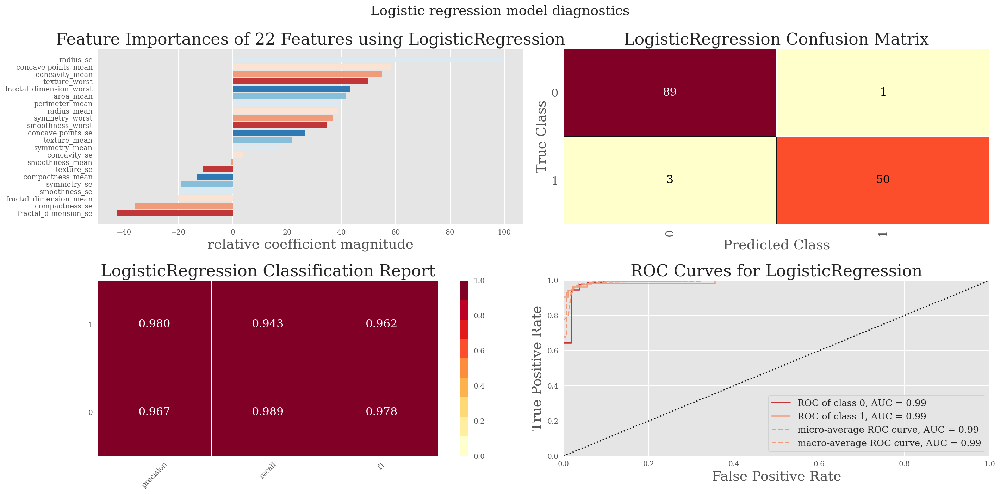

In [ ]:
rc('text', usetex=False)
fig, axes = plt.subplots(2, 2)
#plt.figure(figsize=(20,20))
model = classifier
visualgrid = [
    FeatureImportances(model, ax=axes[0][0]),
    ConfusionMatrix(model, ax=axes[0][1], pos_label='M'),
    ClassificationReport(model, ax=axes[1][0], pos_label='M'),
    ROCAUC(model, classes = ['0', '1'], ax=axes[1][1], pos_label='M'),
]

for viz in visualgrid:
    viz.fit(X_train, y_train,)
    viz.score(X_test, y_test,)
    viz.finalize()

plt.suptitle(r'Logistic regression model diagnostics');
plt.tight_layout();

The model diagnostics show that this model does improve upon the univariate model, especially when it comes to the recall of the positive diagnosis (malignancy).


### Feature Importances

Logistic regression is a linear model; with standardized data, the magnitude of the coefficients gives a sense of the relative feature importance.

In [ ]:
classifier.coef_

array([[ 0.86259654,  0.48315403,  0.86999955,  0.92467328, -0.01134028,
        -0.29518512,  1.21567319,  1.29421489,  0.3851964 , -0.44582747,
         2.21510349, -0.24286385, -0.43423556, -0.7981577 ,  0.08384081,
         0.58577356, -0.4215542 , -0.94427   ,  1.10775072,  0.76534023,
         0.81613275,  0.96126048]])

In [ ]:
importances = {}

# normalize coefficients
total = sum([abs(x) for x in classifier.coef_[0]])

normed = [abs(x)/total for x in classifier.coef_[0]]


for k, v in zip(X_scaled.columns, normed):
    importances[k] = v

relative_imp = {k: v for k, v in sorted(importances.items(), key=lambda item: item[1], reverse=True)}

keys =[]
values = []

for k, v in relative_imp.items():
    keys.append(k)
    values.append(v*100)

df = pd.DataFrame(data={'feature': keys, 'important (%)': values})
df

,feature,important (%)
0,radius_se,$13.70
1,concave points_mean,$8.01
2,concavity_mean,$7.52
3,texture_worst,$6.85
4,fractal_dimension_worst,$5.95
5,fractal_dimension_se,$5.84
6,area_mean,$5.72
7,perimeter_mean,$5.38
8,radius_mean,$5.34
9,symmetry_worst,$5.05


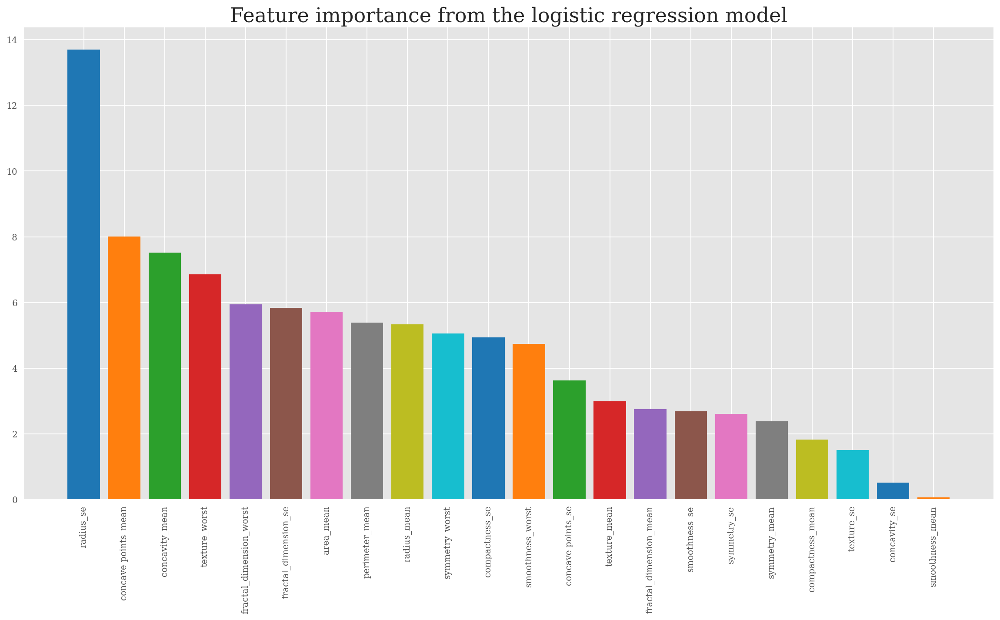

In [ ]:

plt.bar( height=df['important (%)'], x=df.feature,
        color=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
               '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf'])
plt.xticks(rotation = 'vertical');
plt.title('Feature importance from the logistic regression model');

#### Shapley Values

Recall that using Shapley values approach is a more general -- and reliable -- way to determine feature importances for a supervised learning model. Let us, therefore, see what it has to say.

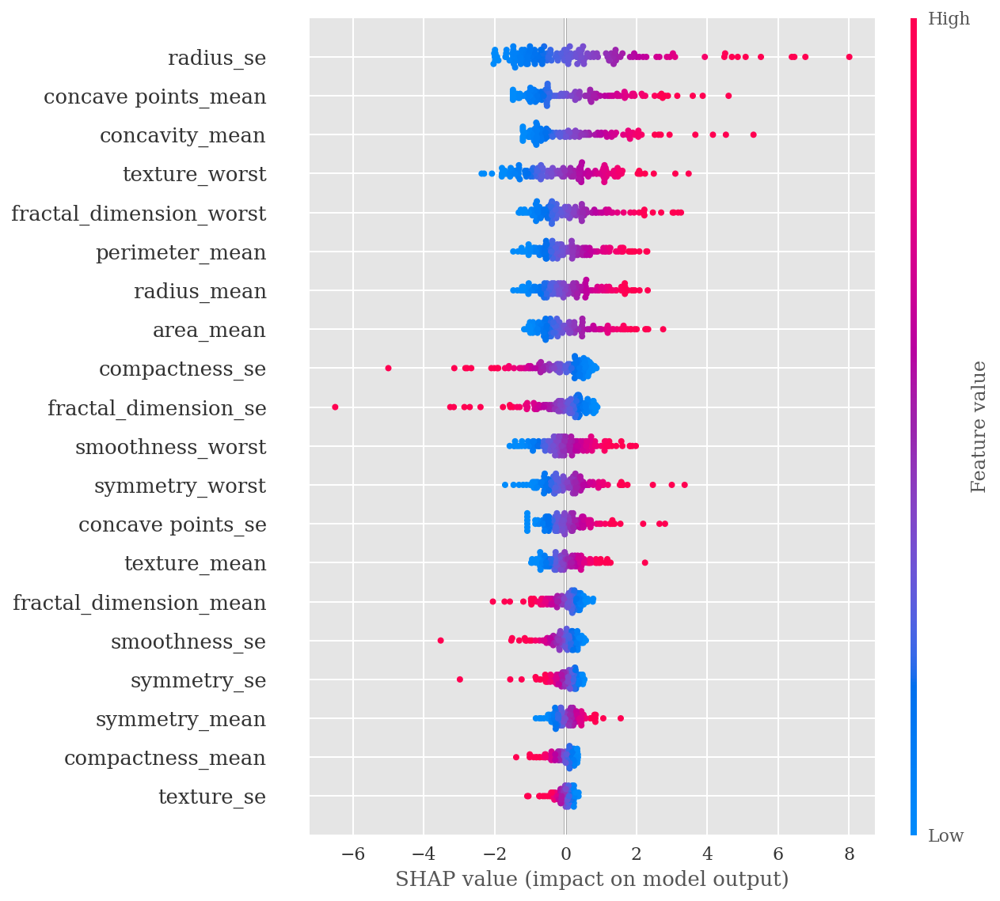

In [ ]:
# explain the model's predictions using SHAP
import shap
explainer = shap.LinearExplainer(classifier, X_train)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test, feature_names=X_train.columns)

#### Partial Dependence Plots

Computing partial dependence plots...


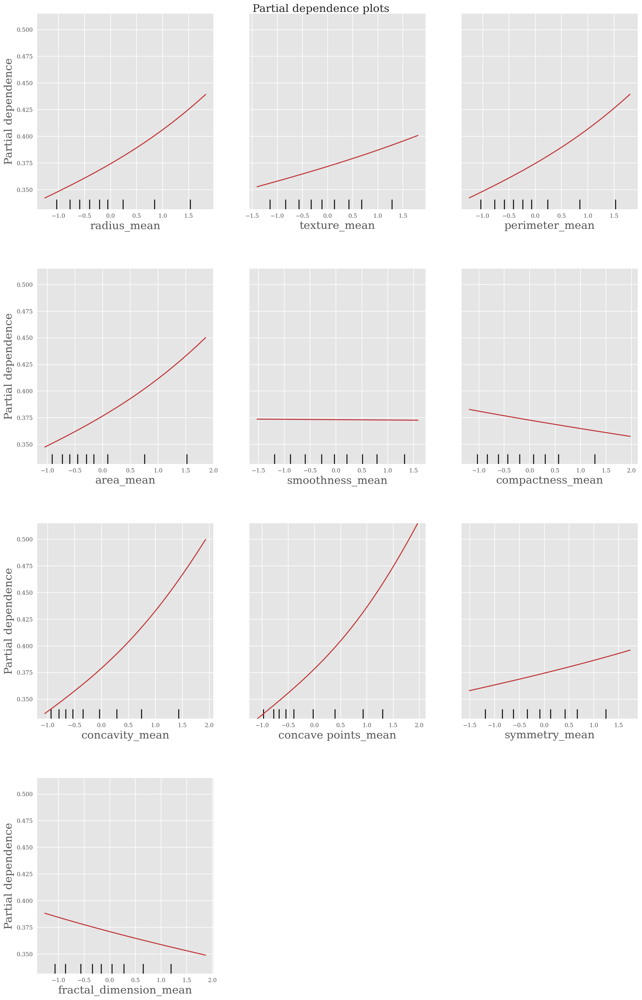

In [ ]:
from sklearn.inspection import partial_dependence
from sklearn.inspection import plot_partial_dependence
print('Computing partial dependence plots...')

features = X_train.columns
plot_partial_dependence(classifier, X_train, features[:10],
                        n_jobs=3, grid_resolution=200,)

fig = plt.gcf()
fig.set_size_inches(16,25)
fig.suptitle(r'''Partial dependence plots''')
fig.subplots_adjust(hspace=0.3)
plt.tight_layout()

### Visual model predictions

It is not easy to visualize the predictions of this complex model directly. Here, we will take two of the predictors, and play with it.

In [ ]:
X, y = data[['area_mean', 'concavity_mean']], data.label
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
classifier =  LogisticRegression(solver='newton-cg')
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
confusion_matrix_ = confusion_matrix(y_test, y_pred)
print(confusion_matrix_)
print(classification_report(y_test, y_pred))
print("{:5}: {} ".format('Classes',classifier.classes_))
print('{:5}: {} '.format('Coefficients',classifier.coef_))
print('{:5}: {} '.format('Intercept', classifier.intercept_))

[[86  4]
 [ 8 45]]
              precision    recall  f1-score   support

           0       0.91      0.96      0.93        90
           1       0.92      0.85      0.88        53

    accuracy                           0.92       143
   macro avg       0.92      0.90      0.91       143
weighted avg       0.92      0.92      0.92       143

Classes: [0 1] 
Coefficients: [[0.01068353 2.69149673]] 
Intercept: [-7.49313282] 


<Figure size 2880x2880 with 0 Axes>

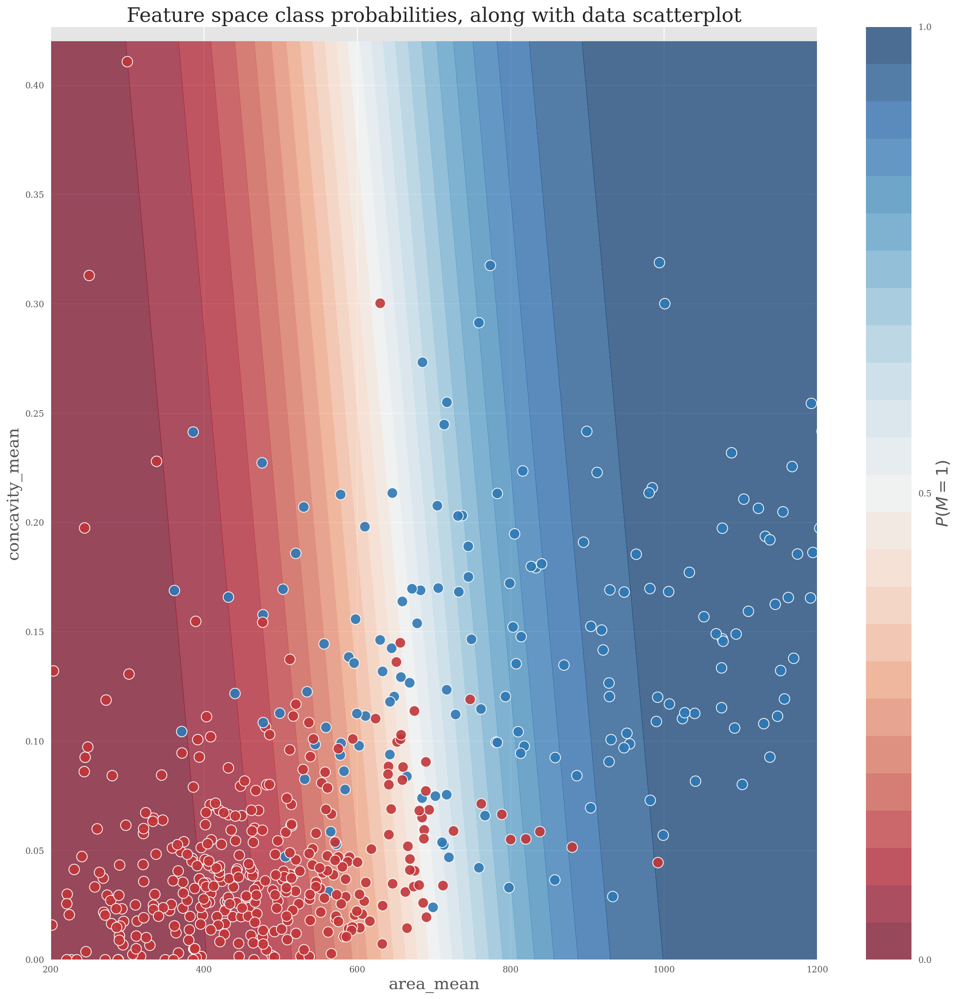

In [ ]:
plt.figure(figsize=(20,20));
x_min, x_max = 200, 1200 # skipping outliers manually
y_min, y_max = X['concavity_mean'].min(), X['concavity_mean'].max()

sample_x, sample_y = np.mgrid[x_min:x_max:.1,
                              y_min:y_max:.01]
grid = np.c_[sample_x.ravel(), sample_y.ravel()]

probs = classifier.predict_proba(grid)[:, 1].reshape(sample_x.shape)

# Now let us draw the decision-boundary
figure, axes = plt.subplots(figsize=(20,20),);
contour = axes.contourf (sample_x,
                         sample_y,
                         probs,
                         25,
                         cmap="RdBu",
                         vmin=0,
                         vmax=1, alpha=0.7);
axes_color = figure.colorbar(contour)
axes_color.set_label("$P(M=1)$")
axes_color.set_ticks ([0.0, 0.5, 1.0])


# Draw the scatterplot
axes.scatter(X['area_mean'],
             X['concavity_mean'],
             c=y,
             s=150,
             cmap="RdBu",
             vmin=-0.2,
             vmax=1.2,
             edgecolor="white",
             linewidth=1,
             alpha=0.9);

#Labels, etc.
axes.set(#aspect="equal",
         xlim=(x_min,x_max),
         ylim=(y_min,y_max),
         xlabel=r'area_mean',
         ylabel=r'concavity_mean'
        );

plt.title(r'Feature space class probabilities, along with data scatterplot');